In [446]:
%matplotlib notebook
from JSAnimation.IPython_display import display_animation
import numpy as np
from math import pi
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import matplotlib.gridspec as gridspec
import pylab as pl
import cmath
from IPython.display import HTML


class CircleAnim:
    """A class that allows you to create and play circle notation through an array of statevectors"""
    def __init__(self, statevectors):
        self.statevectors = statevectors
        self.phase_offset = pi/2
        self.amp_steps = self.calc_amp_steps()
        self.phase_steps = self.calc_phase_steps()
        self.axis = []
        self.anim = None

        
    def calc_phase_steps(self):
        nstates = len(self.statevectors)
        phase_steps = []
        for n in range(nstates - 1):
            phases = np.linspace([cmath.phase(x) for x in self.statevectors[n]], [cmath.phase(x) for x in self.statevectors[n+1]], 100)
            phase_steps.extend(phases)
        return(phase_steps)

    def calc_amp_steps(self):
        nstates = len(self.statevectors)
        amp_steps = []
        for n in range(nstates -1):
            steps = np.linspace(np.absolute(self.statevectors[n]), np.absolute(self.statevectors[n+1]), 100)
            amp_steps.extend(steps)
        return(amp_steps)        
    
    def update(self, curr):
        if curr == 5000:
            self.anim.event_source.stop()
        for i in range(len(self.axis)):
            # clear axis
            self.axis[i].cla()
            
            # set draw a circle representing the amplitude of the state
            amp = self.amp_steps[curr][i]
            circle = pl.Circle((0, 0), amp, transform=self.axis[i].transData._b, color="red", alpha=0.6)
            self.axis[i].add_artist(circle)
            
            # draw a line representing the phase of the state
            theta = self.phase_steps[curr][i] + self.phase_offset
            line, = self.axis[i].plot([0,theta], [0,1], color='blue')
            
            # Label each axis for the state it represents and remove labels on the outside of the axis
            self.axis[i].title.set_text('|%s>'%i)
            self.axis[i].set_xticklabels([])

            
    def create_grid(self, rows, cols):
        qbits = len(self.statevectors[0])
        if rows == 1:
            cols = qbits
        if rows*cols != qbits:
            print("Rows and columns do not match the number of states needed to represent this number of qbits.")
        gspec = gridspec.GridSpec(rows, cols)
        plt.figure()
        axis = []
        for col in range(cols):
            for row in range(rows):
                axis.append(plt.subplot(gspec[row, col], polar=True))
#         gspec.update(wspace = 1, hspace = 1)
        self.axis = axis 
        
    def animate(self, rows=1, cols=1):
        self.create_grid(rows, cols)
        fig = plt.gcf()
        self.anim = animation.FuncAnimation(fig, self.update, interval = 10, repeat=False, save_count=len(self.amp_steps))

In [447]:
'''These state vectors are from qiskit, it coincides with an x, gate, an h gate, 
and then a control not gate from the first qbit to the second. This is an entangled bell state.'''
s1 = [1.+0.j, 0.+0.j, 0.+0.j, 0.+0.j]
s2 = [0.+0.j, 1.+0.j, 0.+0.j, 0.+0.j]
s3 = [ 0.70710678+0.j, -0.70710678+0.j,  0.        +0.j,  0.        +0.j]
s4 = [ 0.70710678+0.j,  0.        +0.j,  0.        +0.j, -0.70710678+0.j]

In [448]:
# Arranging the statevectors into a sequential array
statevectors = [s1,s2,s3,s4]

In [449]:
# creating a CicleAnim object with our statevectors as its input
a = CircleAnim(statevectors)

<IPython.core.display.Javascript object>


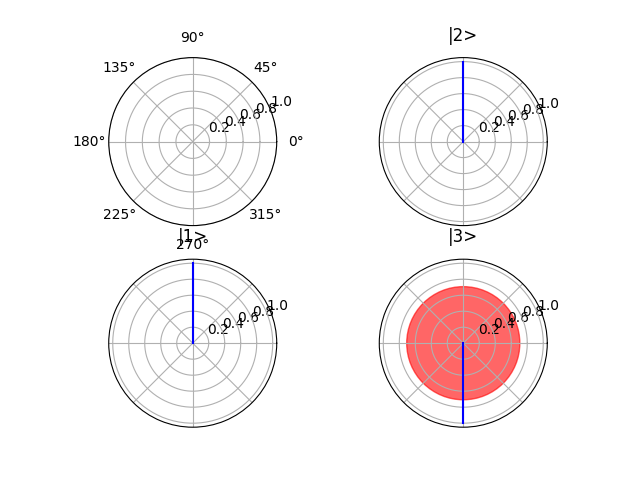

In [450]:
# Creating the animation. I want to specify that I want these 4 states represented in a 2X2 Grid
a.animate(rows=2,cols=2)


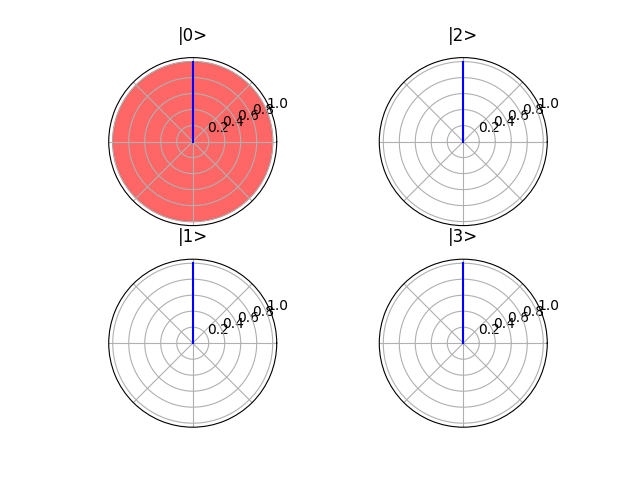
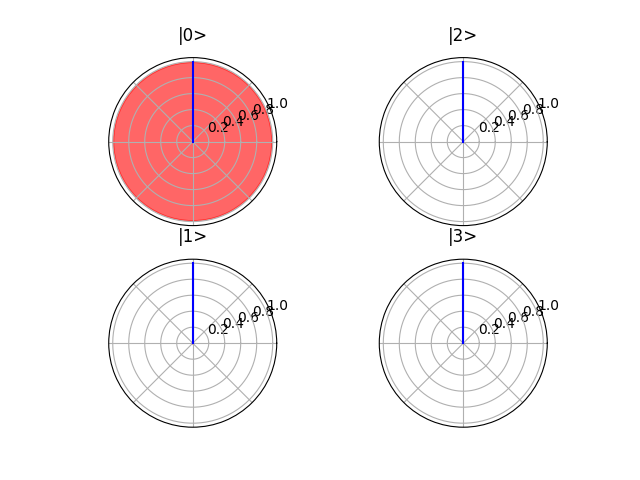
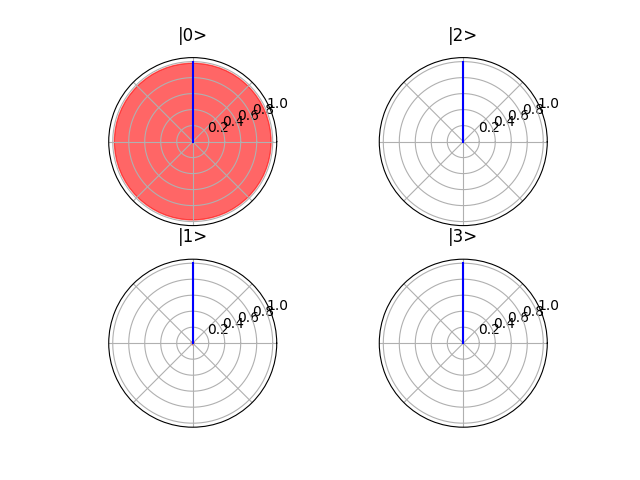
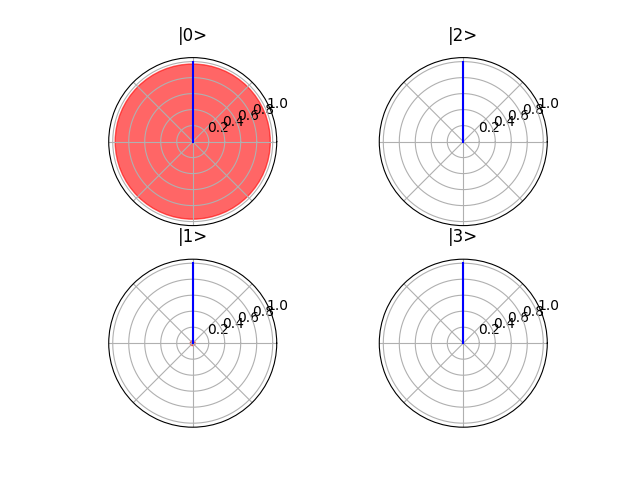
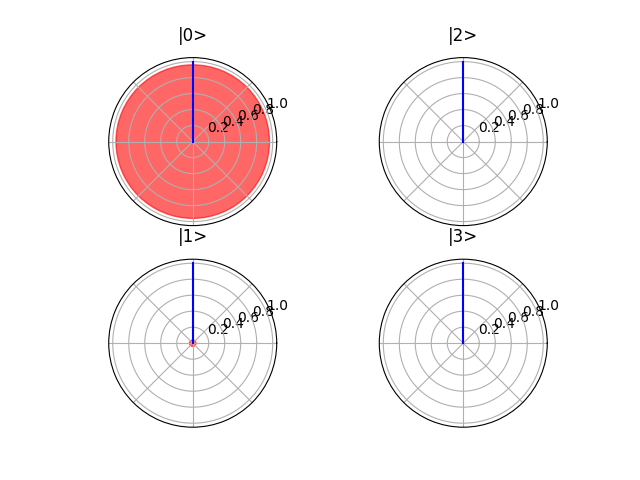
...
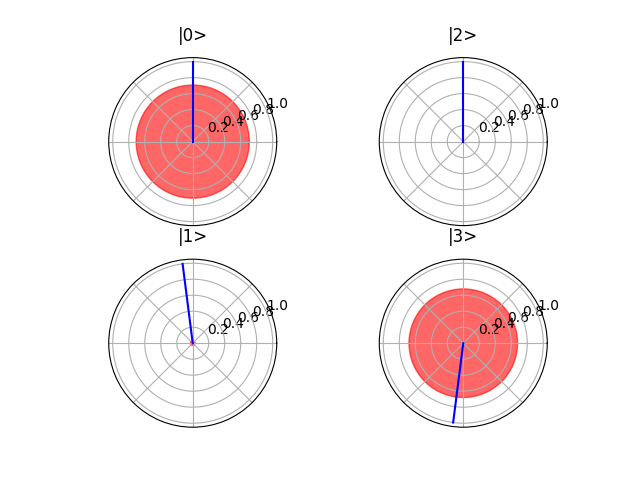
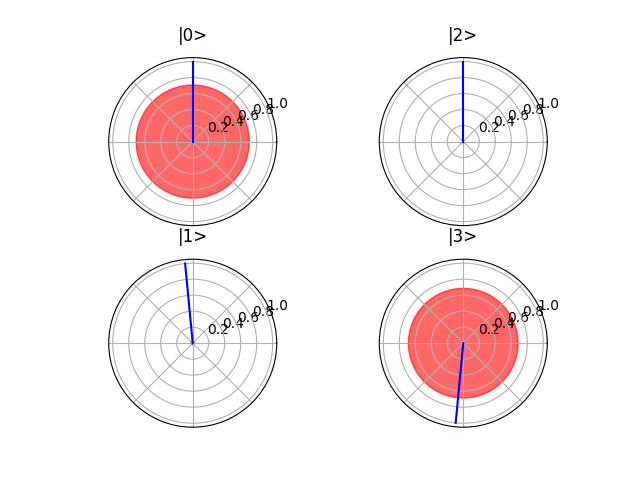
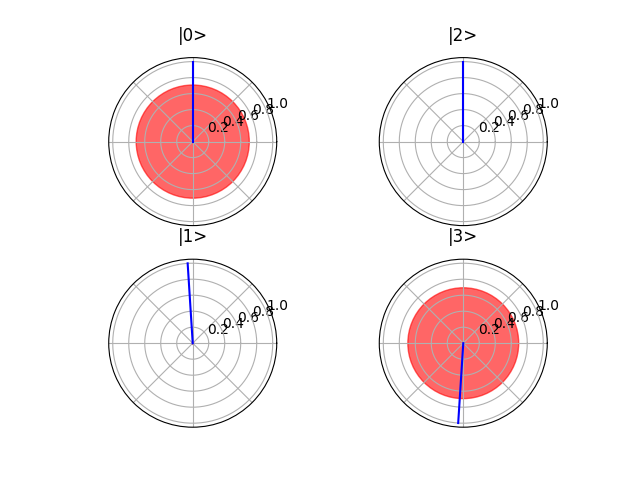
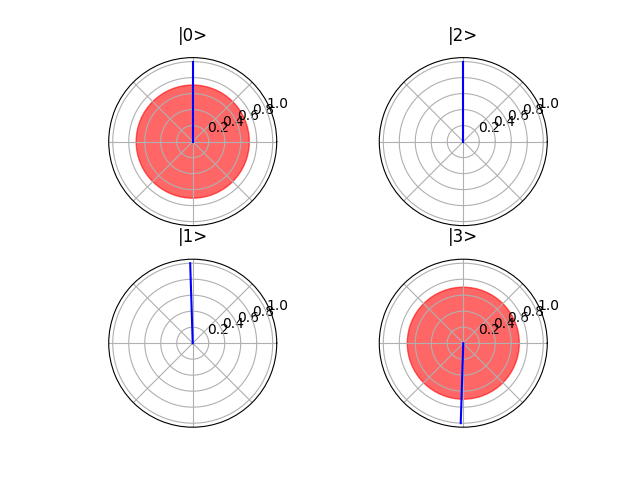
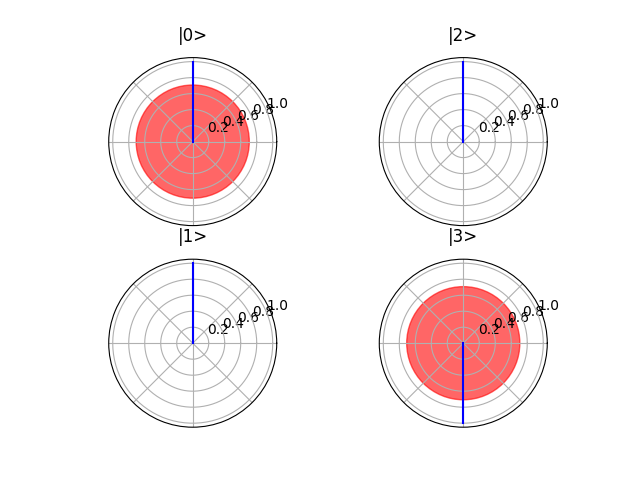

In [444]:
# Creating a nicer animation using JSAnimation. Its slower to make, but is better looking and has more control options
display_animation(a.anim)